Código adaptado del ejemplo presentado en la documentación de Tensorflow

## Configuraciones previas

Instalación del modelo Pix2Pix el cual cuenta con un modelo de generador y discriminador ya elaborado para la prueba del baseline

In [1]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to /tmp/pip-req-build-btz8qfnd
  Running command git clone -q https://github.com/tensorflow/examples.git /tmp/pip-req-build-btz8qfnd
  Created wheel for tensorflow-examples: filename=tensorflow_examples-2a49e4e34d6fbfe2ce1451797026856edfda02fa_-cp37-none-any.whl size=265842 sha256=3dd67608824dbf724a66c7946cba3fc2793f623f524022322a64685d9da2fa0d
  Stored in directory: /tmp/pip-ephem-wheel-cache-4s1x3em8/wheels/83/64/b3/4cfa02dc6f9d16bf7257892c6a7ec602cd7e0ff6ec4d7d714d
Successfully built tensorflow-examples


In [2]:
%tensorflow_version 2.x
import tensorflow as tf


In [3]:
import tensorflow_datasets as tfds
from tensorflow_examples.models.pix2pix import pix2pix

import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output

AUTOTUNE = tf.data.AUTOTUNE

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Carga de las rutas de las imágenes para el entrenamiento

In [6]:
# Ruta principal
PATH = "/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Data/download_images_1"

# Imagenes de entrada
INPUT = "/landscape_draw"

# Imagenes de salida
OUTPUT = "/adventure_time"

# Path de los checkpoints
CHK_PATH = "/checkpoints"

In [7]:
COMPLETE_INPUT_PATH = f'{PATH}/{INPUT}'
COMPLETE_OUTPUT_PATH = f'{PATH}/{OUTPUT}'

In [8]:
imgsInputPaths = !ls -1 '{COMPLETE_INPUT_PATH}'
imgsOutputPaths = !ls -1 '{COMPLETE_OUTPUT_PATH}'

In [9]:
imgsInputPaths = [f'{PATH}{INPUT}/{filename}' for filename in imgsInputPaths]
imgsOutputPaths = [f'{PATH}{OUTPUT}/{filename}' for filename in imgsOutputPaths]

In [10]:
imgsInputPaths[0]

'/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Data/download_images_1/landscape_draw/0.jpeg'

In [11]:
imgsOutputPaths[0]

'/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Data/download_images_1/adventure_time/010.jpg'

In [12]:
# Train and test partitions
N = min(len(imgsInputPaths),len(imgsOutputPaths))
N_TRAIN = round(N*0.75)
print("N", N)
print("N_TRAIN", N_TRAIN)

N 156
N_TRAIN 117


In [13]:
N-N_TRAIN

39

In [14]:
# Training images paths
trainPathsI = imgsInputPaths[:N_TRAIN]
testPathsI = imgsInputPaths[N_TRAIN:N]

# Tests images paths
trainPathsO = imgsOutputPaths[:N_TRAIN]
testPathsO = imgsOutputPaths[N_TRAIN:N]

In [15]:
print(trainPathsI[0])
print(testPathsO[0])

/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Data/download_images_1/landscape_draw/0.jpeg
/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Data/download_images_1/adventure_time/43.jpeg


## Funciones y parámetros para la carga de datos

In [16]:
BUFFER_SIZE = 20
BATCH_SIZE = 1
IMG_WIDTH = 180
IMG_HEIGHT = 180
CROP_IMG_WIDTH = 256
CROP_IMG_HEIGHT = 256

In [17]:
def resize(image, test=True):
  image = tf.image.resize(image, 
                          [CROP_IMG_HEIGHT if test else IMG_HEIGHT,
                           CROP_IMG_WIDTH if test else IMG_WIDTH],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return image

In [18]:
def random_crop(image):
  cropped_image = tf.image.random_crop(
      image, size=[CROP_IMG_HEIGHT, CROP_IMG_WIDTH, 3])

  return cropped_image

In [19]:
def random_jitter(image):
  # Recorte aleatorio
  image = random_crop(image)

  # Giro horizontal aleatorio
  image = tf.image.random_flip_left_right(image)

  return image

In [20]:
# Funcion de normalizacion [-1, 1]
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [21]:
def preprocess_image_train(image, label):
  image = random_jitter(image)
  image = normalize(image)
  return image

In [22]:
def preprocess_image_test(image, label):
  image = normalize(image)
  return image

In [23]:
def load_image(filename):
  img = tf.cast(tf.image.decode_jpeg(tf.io.read_file(filename)), tf.float32)
  if tf.shape(img)[2] == 1:
    img = tf.image.grayscale_to_rgb(img)
  img = img[..., :3]
  return img

In [24]:
def load_image_train(filename):
  image = load_image(filename)
  image = resize(image, test=True)
  image = random_jitter(image)
  image = normalize(image)
  return image

In [25]:
def load_image_test(filename):
  image = load_image(filename)
  image = resize(image, test=True)
  image = normalize(image)
  return image

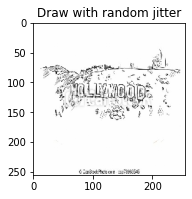

In [26]:
plt.subplot(122)
plt.title('Draw with random jitter')
img = load_image_train(trainPathsI[10])
plt.imshow(img * 0.5 + 0.5)

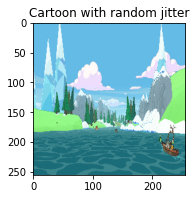

In [28]:
plt.subplot(122)
plt.title('Cartoon with random jitter')
img = load_image_test(trainPathsO[10])
plt.imshow(img * 0.5 + 0.5)

## Carga de datos

In [27]:
train_draw = tf.data.Dataset.from_tensor_slices(trainPathsI)
train_draw = train_draw.cache().map(load_image_train, num_parallel_calls=AUTOTUNE).shuffle(BUFFER_SIZE)
train_draw = train_draw.batch(BATCH_SIZE)

train_cartoon = tf.data.Dataset.from_tensor_slices(trainPathsO)
train_cartoon = train_cartoon.cache().map(load_image_train, num_parallel_calls=AUTOTUNE).shuffle(BUFFER_SIZE)
train_cartoon = train_cartoon.batch(BATCH_SIZE)

test_draw = tf.data.Dataset.from_tensor_slices(testPathsI)
test_draw = test_draw.cache().map(load_image_test, num_parallel_calls=AUTOTUNE).shuffle(BUFFER_SIZE)
test_draw = test_draw.batch(BATCH_SIZE)

test_cartoon = tf.data.Dataset.from_tensor_slices(testPathsO)
test_cartoon = test_cartoon.cache().map(load_image_test, num_parallel_calls=AUTOTUNE).shuffle(BUFFER_SIZE)
test_cartoon = test_cartoon.batch(BATCH_SIZE)

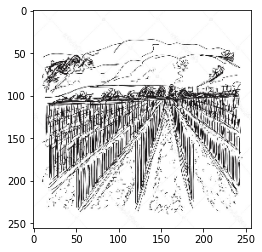

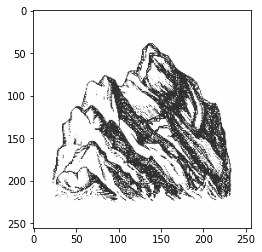

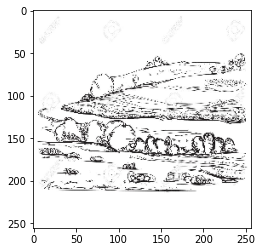

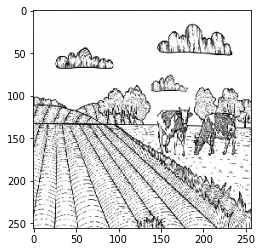

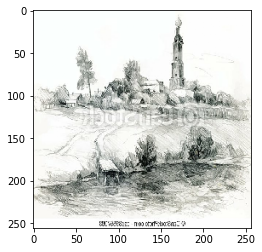

In [30]:
for simg in train_draw.take(2):
  plt.imshow(simg[0,...] * 0.5 + 0.5)
  plt.show()

In [28]:
sample_draw = next(iter(train_draw))
sample_cartoon = next(iter(train_cartoon))

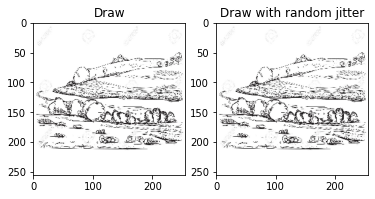

In [32]:
plt.subplot(121)
plt.title('Draw')
plt.imshow(sample_draw[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Draw with random jitter')
plt.imshow(random_jitter(sample_draw[0]) * 0.5 + 0.5)

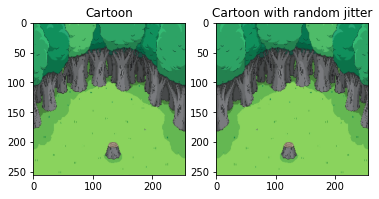

In [33]:
plt.subplot(121)
plt.title('Cartoon')
plt.imshow(sample_cartoon[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Cartoon with random jitter')
plt.imshow(random_jitter(sample_cartoon[0]) * 0.5 + 0.5)

## Carga de los generadores y discriminadores

In [29]:
OUTPUT_CHANNELS = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


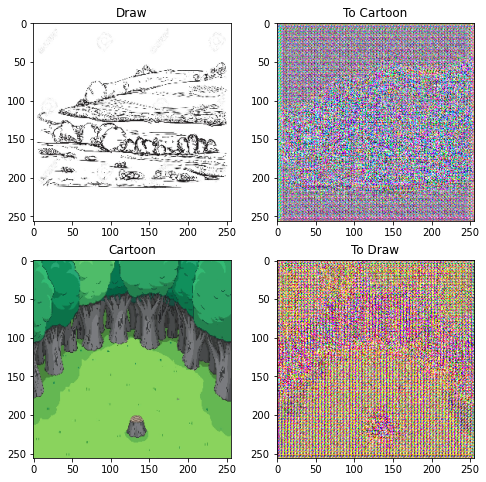

In [35]:
to_cartoon = generator_g(sample_draw)
to_draw = generator_f(sample_cartoon)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_draw, to_cartoon, sample_cartoon, to_draw]
title = ['Draw', 'To Cartoon', 'Cartoon', 'To Draw']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

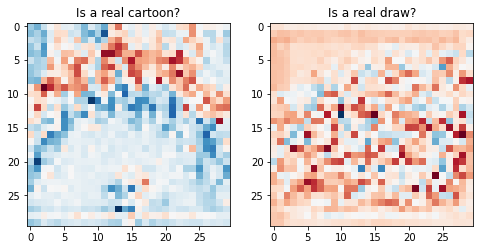

In [36]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is a real cartoon?')
plt.imshow(discriminator_y(sample_cartoon)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is a real draw?')
plt.imshow(discriminator_x(sample_draw)[0, ..., -1], cmap='RdBu_r')

plt.show()

## Funciones de perdida

In [30]:
LAMBDA = 10

In [31]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [32]:
def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)

  generated_loss = loss_obj(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [33]:
def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

In [34]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  
  return LAMBDA * loss1

In [35]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

Initialize the optimizers for all the generators and the discriminators.

In [36]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Guardado y carga de los modelos

In [39]:
checkpoint_path = "/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Models/checkpoints_v1"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


## Entrenamiento del modelo

In [45]:
EPOCHS = 50

In [46]:
generated_images_path = "/content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Generated_images/checkpoint_v1"

In [47]:
def generate_images(model, test_input, epoch):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.savefig(f'{generated_images_path}/img_{epoch}.jpeg')
  plt.show()

In [48]:
@tf.function
def train_step(real_x, real_y):
  with tf.GradientTape(persistent=True) as tape:
    # Generador G: Dibujos -> Caricatura
    # Generador F: Caricatura -> Dibujos.
    
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # Variables para calcular la perdida de identidad
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # Calcular la perdida de los generadores
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)
    
    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
    
    # Perdida total del generador = perdida adversarial + perdida de ciclo
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
  
  # Calculo de las gradientes de los generadores y de los discrimiadores
  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)
  
  # Optimar los gradientes
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))
  
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))
  
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))
  
  return total_gen_g_loss, total_gen_f_loss, disc_x_loss, disc_y_loss

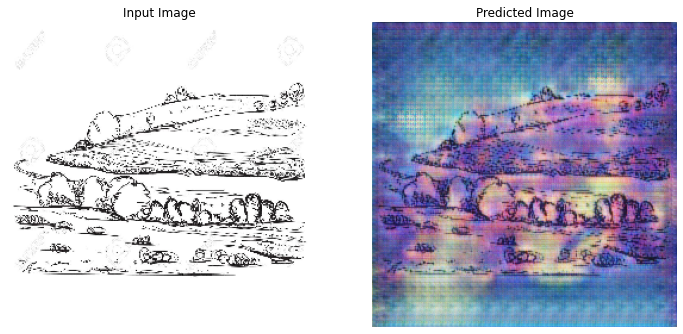

Saving checkpoint for epoch 50 at /content/drive/MyDrive/Colab Notebooks/TAC/TA_2/Models/checkpoints_v1/ckpt-5
Time taken for epoch 50 is 57.45727181434631 sec

total_gen_g_loss 4.818093299865723, total_gen_f_loss 7.5656304359436035, disc_x_loss 0.4674363136291504, disc_y_loss 0.6446043848991394


In [49]:
lst_loss = []
for epoch in range(EPOCHS):
  start = time.time()

  n = 0
  for image_x, image_y in tf.data.Dataset.zip((train_draw, train_cartoon)):
    total_gen_g_loss, total_gen_f_loss, disc_x_loss, disc_y_loss = train_step(image_x, image_y)
    lst_loss.append([total_gen_g_loss, total_gen_f_loss, disc_x_loss, disc_y_loss])
    if n % 10 == 0:
      print ('.', end='')
    n += 1

  clear_output(wait=True)
  generate_images(generator_g, sample_draw, epoch)

  if (epoch + 1) % 10 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                        ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))
  print ('total_gen_g_loss {}, total_gen_f_loss {}, disc_x_loss {}, disc_y_loss {}'.format(total_gen_g_loss, total_gen_f_loss, disc_x_loss, disc_y_loss))

In [66]:
lst_gen_g_loss = [x[0].numpy() for x in lst_loss]
lst_gen_f_loss = [x[1].numpy() for x in lst_loss]
lst_disc_x_loss = [x[2].numpy() for x in lst_loss]
lst_disc_y_loss = [x[3].numpy() for x in lst_loss]

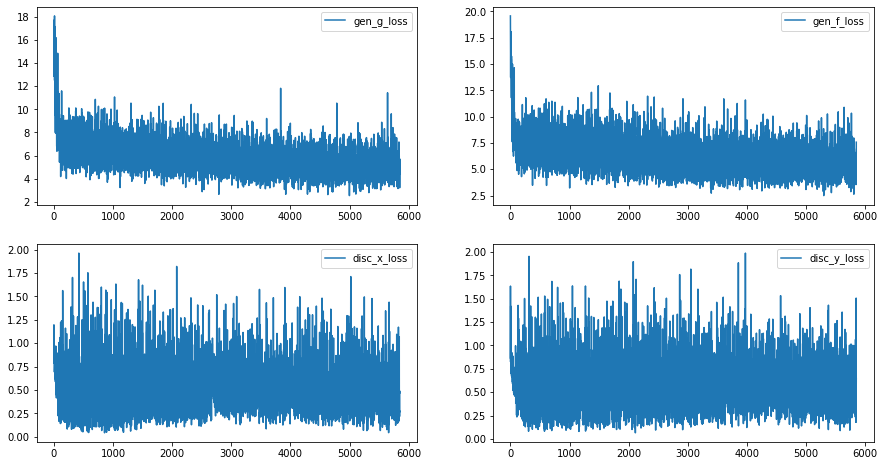

In [86]:
import matplotlib.pyplot as plt
import numpy as np
  
# create data
len_g = list(range(len(lst_gen_g_loss)))
len_f = list(range(len(lst_gen_f_loss)))
len_disc_x = list(range(len(lst_disc_x_loss)))
len_disc_y = list(range(len(lst_disc_y_loss)))

fig = plt.figure(figsize = (15,8))

# plot lines
ax = plt.subplot(2,2,1)
ax.plot(len_g, lst_gen_g_loss, label = "gen_g_loss")
ax.legend()

ax = plt.subplot(2,2,2)
ax.plot(len_f, lst_gen_f_loss, label = "gen_f_loss")
ax.legend()

ax = plt.subplot(2,2,3)
ax.plot(len_disc_x, lst_disc_x_loss, label = "disc_x_loss")
ax.legend()

ax = plt.subplot(2,2,4)
ax.plot( len_disc_y, lst_disc_y_loss, label = "disc_y_loss")
ax.legend()

plt.savefig("losses-baseline-50epochs.svg")

## Generate using test dataset

In [41]:
def plot_images(model, test_input, save=False):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  if save:
    plt.savefig("cartoon-draw-baseline-50.jpg")
  plt.show()

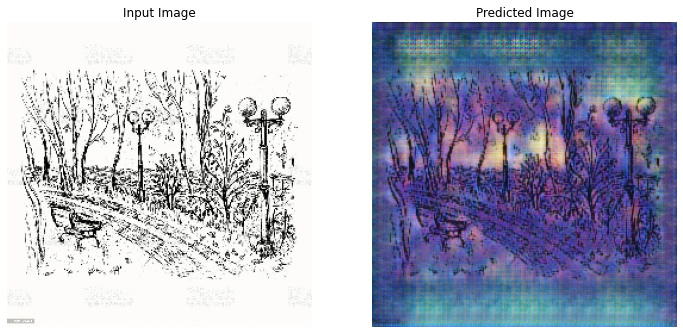

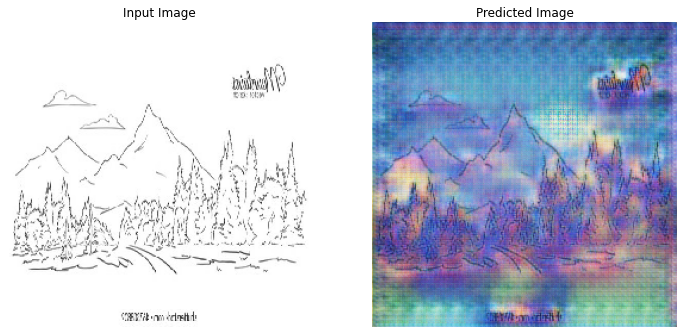

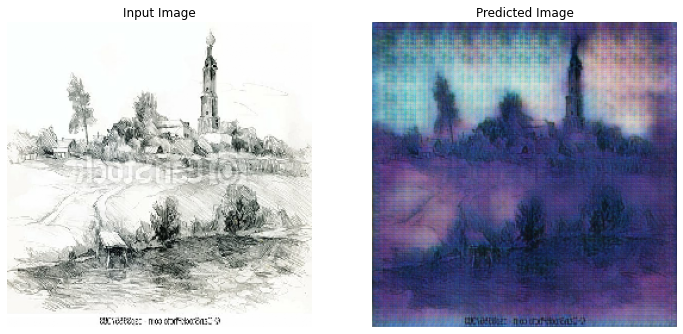

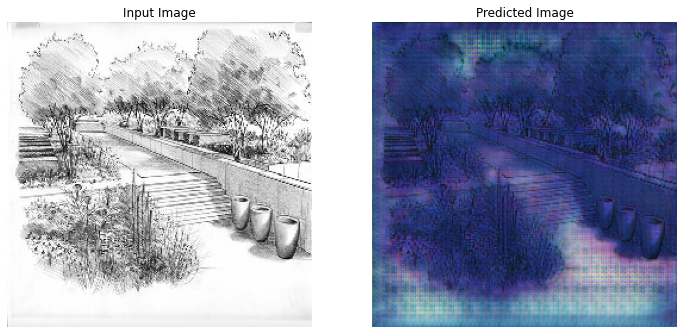

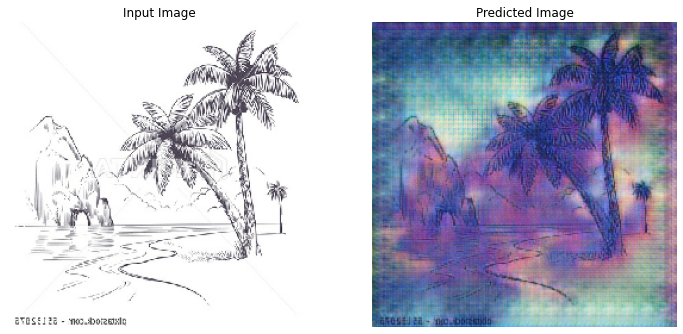

...

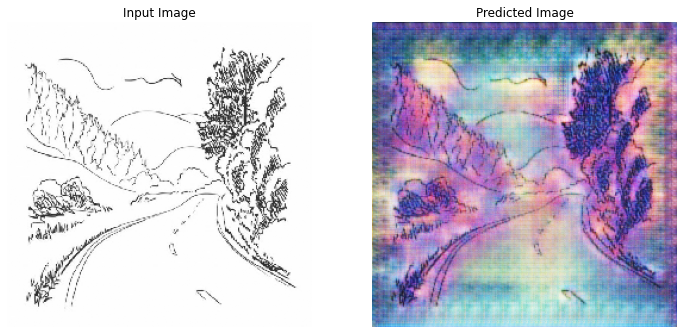

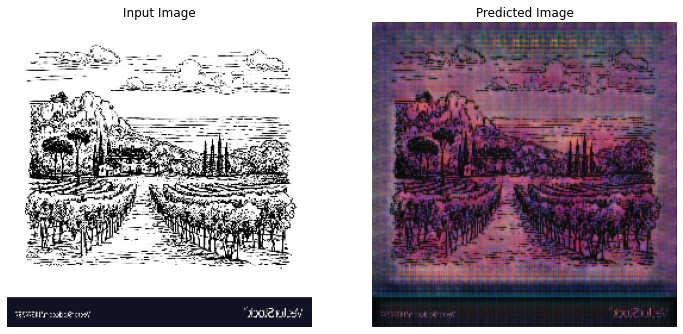

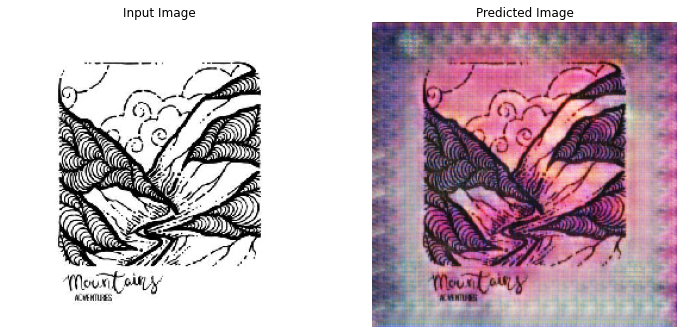

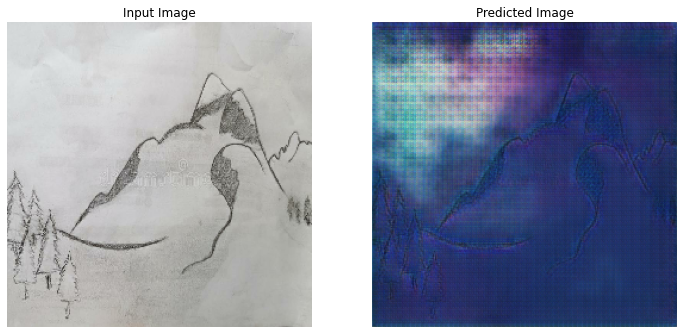

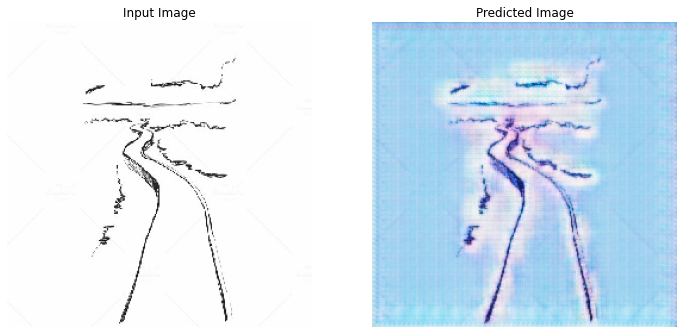

In [78]:
# Run the trained model on the test dataset
for inp in train_draw.take(50):
  plot_images(generator_g, inp)

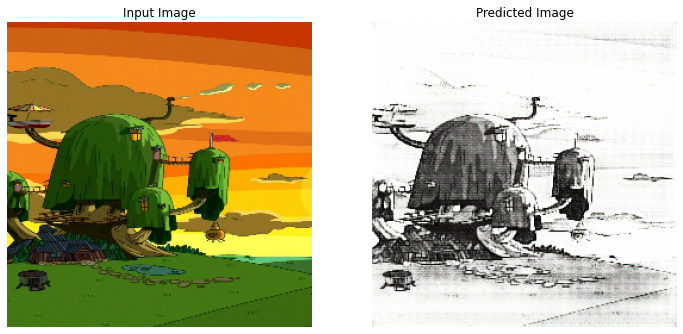

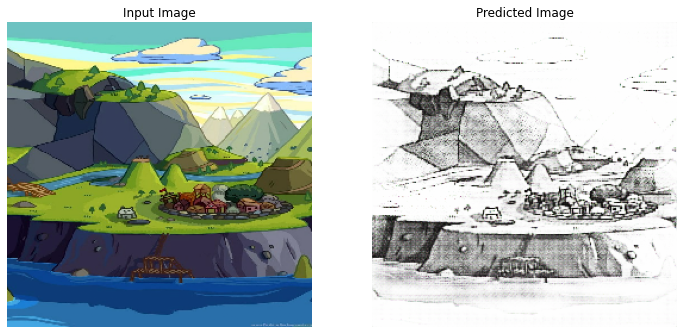

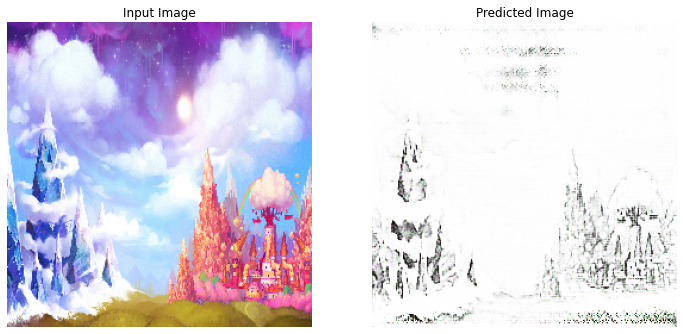

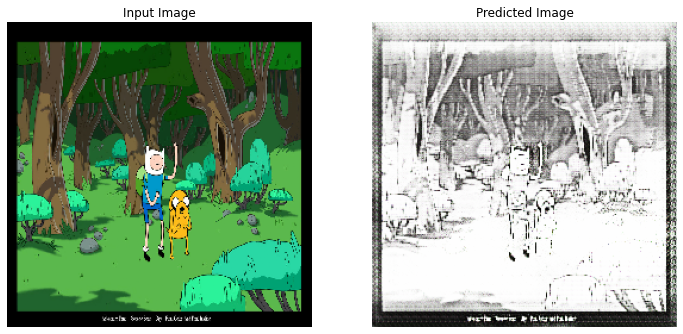

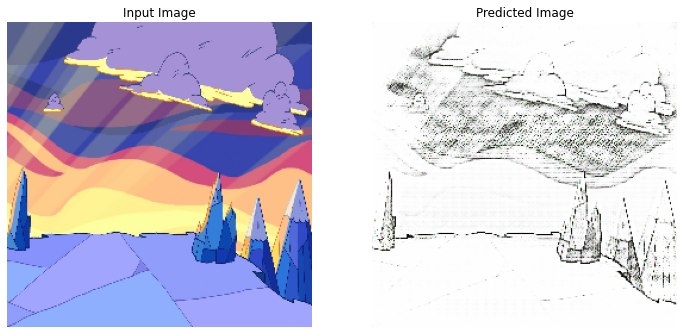

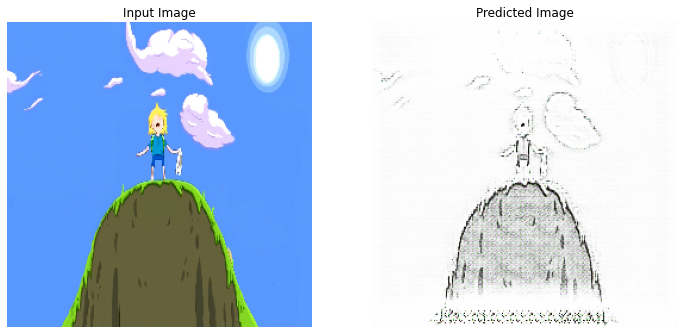

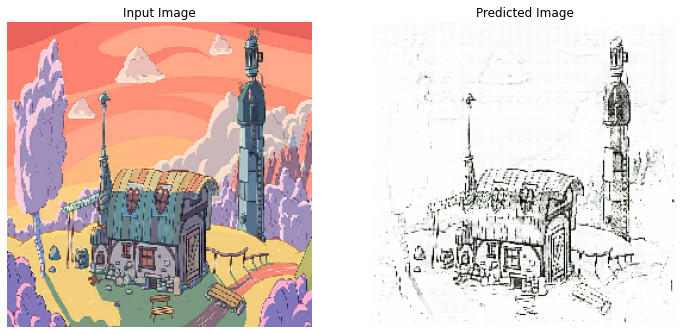

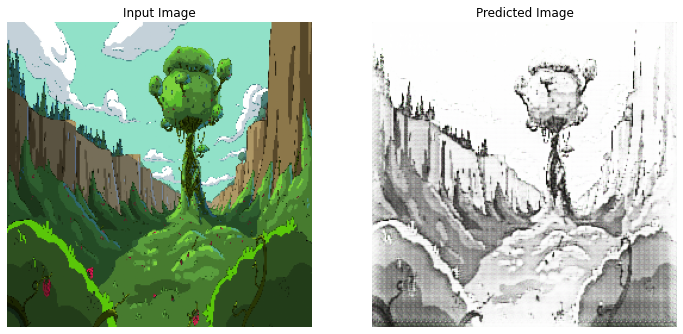

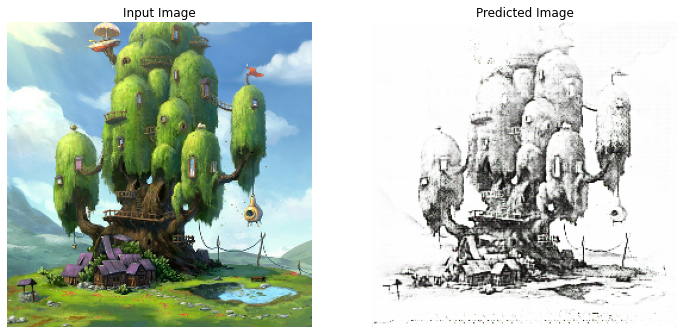

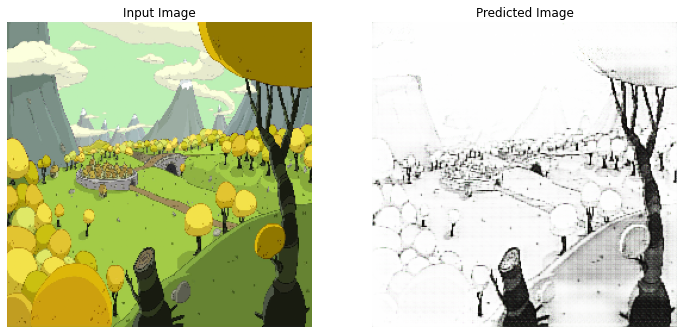

In [42]:
for inp in test_cartoon.take(10):
  plot_images(generator_f, inp)